In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import pandas_profiling as pp
%matplotlib inline

In [2]:
df = pd.read_csv('data-FPBfZ.csv')

In [3]:
df.shape

(3142, 7)

In [4]:
df = df.rename(columns = {"ICU Beds":"ICU_Beds","Total Population":"Total_Population","Population Aged 60+":"Population_Aged_60+","Percent of Population Aged 60+":"Percent_Population_Aged_60","Residents Aged 60+ Per Each ICU Bed":"Residents_Per_ICU_Bed"})

In [5]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
ICU_Beds,3142.0,23.802355,84.577223,0.0,0.00,0.0,12.00,2126.0
Total_Population,3142.0,102165.629217,328292.195145,74.0,10945.25,25691.5,67445.00,10105722.0
Population_Aged_60+,3142.0,21310.136537,61388.442588,27.0,2813.25,6307.0,16083.75,1800341.0
Percent_Population_Aged_60,3142.0,24.732113,5.566586,5.8,21.20,24.4,27.80,64.2
Residents_Per_ICU_Bed,1476.0,1299.560298,891.101330,10.0,713.00,1089.0,1639.00,8469.0


In [6]:
#pp.ProfileReport(df)

In [7]:
by_state = df.groupby('State')[['ICU_Beds']].sum()

In [8]:
by_state.head()

,ICU_Beds
State,
Alabama,1533
Alaska,119
Arizona,1559
Arkansas,732
California,7338


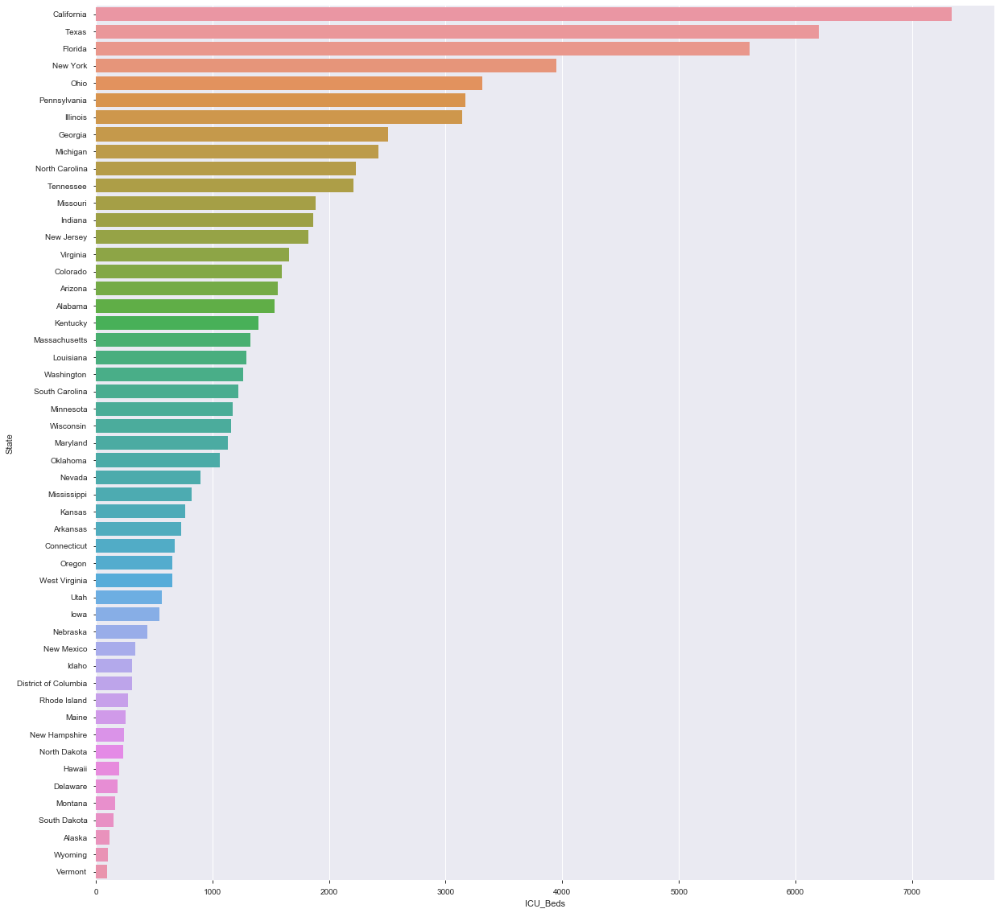

In [9]:
plt.figure(figsize=(20,20))
ax = sns.barplot(x = "ICU_Beds", y ='State', data = by_state.reset_index().sort_values(by=['ICU_Beds'], ascending = False))

In [10]:
fip_codes_df = pd.read_csv('https://raw.githubusercontent.com/kjhealy/fips-codes/master/county_fips_master.csv', encoding = "ISO-8859-1")

In [11]:
fip_codes_df['county_name'] = fip_codes_df['county_name'].apply(lambda x: x.replace(' County', ''))

In [13]:
fip_codes = fip_codes_df.set_index('county_name')['fips'].to_dict()

In [12]:
fip_codes_df

,fips,county_name,state_abbr,state_name,long_name,sumlev,region,division,state,county,crosswalk,region_name,division_name
0,1001,Autauga,AL,Alabama,Autauga County AL,50.0,3.0,6.0,1.0,1.0,3-6-1-1,South,East South Central
1,1003,Baldwin,AL,Alabama,Baldwin County AL,50.0,3.0,6.0,1.0,3.0,3-6-1-3,South,East South Central
2,1005,Barbour,AL,Alabama,Barbour County AL,50.0,3.0,6.0,1.0,5.0,3-6-1-5,South,East South Central
3,1007,Bibb,AL,Alabama,Bibb County AL,50.0,3.0,6.0,1.0,7.0,3-6-1-7,South,East South Central
4,1009,Blount,AL,Alabama,Blount County AL,50.0,3.0,6.0,1.0,9.0,3-6-1-9,South,East South Central
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3141,56037,Sweetwater,WY,Wyoming,Sweetwater County WY,50.0,4.0,8.0,56.0,37.0,4-8-56-37,West,Mountain
3142,56039,Teton,WY,Wyoming,Teton County WY,50.0,4.0,8.0,56.0,39.0,4-8-56-39,West,Mountain
3143,56041,Uinta,WY,Wyoming,Uinta County WY,50.0,4.0,8.0,56.0,41.0,4-8-56-41,West,Mountain
3144,56043,Washakie,WY,Wyoming,Washakie County WY,50.0,4.0,8.0,56.0,43.0,4-8-56-43,West,Mountain


In [14]:
df['county_fips_code'] = df['County'].apply(lambda x: fip_codes.get(x))

In [16]:
df_county = df[pd.notnull(df['county_fips_code'])]

In [18]:
import plotly.figure_factory as ff

In [15]:
df.head()

,State,County,ICU_Beds,Total_Population,Population_Aged_60+,Percent_Population_Aged_60,Residents_Per_ICU_Bed,county_fips_code
0,Alabama,Autauga,6,55036,10523,19.1,1754.0,1001.0
1,Alabama,Baldwin,51,203360,53519,26.3,1049.0,13009.0
2,Alabama,Barbour,5,26201,6150,23.5,1230.0,54001.0
3,Alabama,Bibb,0,22580,4773,21.1,NaN,13021.0
4,Alabama,Blount,6,57667,13600,23.6,2267.0,47009.0


In [19]:
fips = df_county['county_fips_code'].tolist()
values = df_county['ICU_Beds'].tolist()

In [20]:
"""
colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(1, 12, len(colorscale) - 1))
fips = df_county['county_fips_code'].tolist()
values = df_county['ICU_Beds'].tolist()


fig = ff.create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='ICU Beds per County',
    legend_title='Residents Aged 60+ Per Each ICU Bed'
)

fig.layout.template = None
fig.show()
"""

'\ncolorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",\n              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",\n              "#08519c","#0b4083","#08306b"]\nendpts = list(np.linspace(1, 12, len(colorscale) - 1))\nfips = df_county[\'county_fips_code\'].tolist()\nvalues = df_county[\'ICU_Beds\'].tolist()\n\n\nfig = ff.create_choropleth(\n    fips=fips, values=values,\n    binning_endpoints=endpts,\n    colorscale=colorscale,\n    show_state_data=False,\n    show_hover=True, centroid_marker={\'opacity\': 0},\n    asp=2.9, title=\'ICU Beds per County\',\n    legend_title=\'Residents Aged 60+ Per Each ICU Bed\'\n)\n\nfig.layout.template = None\nfig.show()\n'

In [21]:
import altair as alt

In [22]:
import os

In [23]:
import requests

In [24]:
countWithNoICUBeds = df.query("ICU_Beds==0")

In [26]:
chart = alt.Chart(countWithNoICUBeds).mark_circle(size=50).encode(
    x='Total_Population',
    y='Population_Aged_60+',
    color='State',
    tooltip=['State', 'County','Percent_Population_Aged_60','Population_Aged_60+','Total_Population']
).properties(
    title = "Vulnerable Counties without ICU Beds"
).interactive()
chart.encoding.x.title = 'Total Population'
chart.encoding.y.title = 'Population Aged 60+'
chart


alt.Chart(...)

In [27]:
countiesWithICUBeds = df.query("ICU_Beds>0")

In [28]:
chart = alt.Chart(countiesWithICUBeds).mark_circle(size=50).encode(
    x='Total_Population',
    y='Population_Aged_60+',
    color='State',
    tooltip=['State', 'County','Percent_Population_Aged_60','Population_Aged_60+','Total_Population']
).properties(
    title = "Vulnerable Counties With ICU Beds"
).interactive()
chart.encoding.x.title = 'Total Population'
chart.encoding.y.title = 'Population Aged 60+'
chart

alt.Chart(...)

In [29]:
daily_data = pd.read_csv('us-counties.csv')

In [30]:
daily_data.head()
daily_data = daily_data.rename(columns = {'state':'State', 'county':'County'})


In [31]:
aggregate_data = daily_data.groupby(['State', 'County'])
aggregate_data.head()

,date,County,State,fips,cases,deaths
0,1/21/20,Snohomish,Washington,53061.0,1,0
1,1/22/20,Snohomish,Washington,53061.0,1,0
2,1/23/20,Snohomish,Washington,53061.0,1,0
3,1/24/20,Cook,Illinois,17031.0,1,0
4,1/24/20,Snohomish,Washington,53061.0,1,0
...,...,...,...,...,...,...
23948,3/31/20,Waupaca,Wisconsin,55135.0,1,1
23954,3/31/20,Converse,Wyoming,56009.0,1,0
23956,3/31/20,Goshen,Wyoming,56015.0,1,0
23963,3/31/20,Sublette,Wyoming,56035.0,1,0


In [32]:
aggregate_sums = aggregate_data.agg(np.sum)


fips  cases  deaths
State   County                          
Alabama Autauga    8008.0     43       0
        Baldwin   18054.0     95       0
        Bibb       2014.0      5       0
        Blount     7063.0     29       0
        Bullock    6066.0     16       0
        Butler     7091.0      7       0
        Calhoun   14210.0     40       0
        Chambers  13221.0    166       8
        Cherokee   7133.0     10       0
        Chilton    7147.0     48       0

In [33]:
aggregate_sums.head()

fips  cases  deaths
State   County                         
Alabama Autauga   8008.0     43       0
        Baldwin  18054.0     95       0
        Bibb      2014.0      5       0
        Blount    7063.0     29       0
        Bullock   6066.0     16       0

In [34]:
merged = pd.merge(aggregate_sums, countiesWithICUBeds, left_on = 'State', right_on = 'State')
merged.head()

,State,fips,cases,deaths,County,ICU_Beds,Total_Population,Population_Aged_60+,Percent_Population_Aged_60,Residents_Per_ICU_Bed,county_fips_code
0,Alabama,8008.0,43,0,Autauga,6,55036,10523,19.1,1754.0,1001.0
1,Alabama,8008.0,43,0,Baldwin,51,203360,53519,26.3,1049.0,13009.0
2,Alabama,8008.0,43,0,Barbour,5,26201,6150,23.5,1230.0,54001.0
3,Alabama,8008.0,43,0,Blount,6,57667,13600,23.6,2267.0,47009.0
4,Alabama,8008.0,43,0,Butler,7,20126,5151,25.6,736.0,42019.0


In [35]:
alt.data_transformers.disable_max_rows()


DataTransformerRegistry.enable('default')

In [36]:
alt.Chart(merged).mark_circle(size=50).encode(
    x='cases',
    y='Residents_Per_ICU_Bed',
    color='State',
    tooltip=['State', 'County','Percent_Population_Aged_60','Population_Aged_60+','Total_Population','cases','deaths','Residents_Per_ICU_Bed'],    
).properties(
    title = "Vulnerable Counties with Maximum residents per ICU vs. Cases of COVID19"
).interactive()

alt.Chart(...)